# IMPORT LIBRARIES

In [25]:
import pandas as pd
from sklearn.linear_model import LogisticRegression

import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import xgboost as xgb
from sklearn import metrics
from sklearn.metrics import f1_score, precision_score, recall_score, roc_auc_score, accuracy_score

from sklearn.model_selection import GroupKFold
from collections import Counter
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import precision_score, make_scorer

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# SET AND RESET ROWS AND COLS

In [20]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [3]:
pd.reset_option('display.max_columns')
pd.reset_option('display.max_rows')

# READ CSV FILE

In [26]:
df = pd.read_csv('gaze_fixation_nlp_pp_z_null_data.csv')
df

,Participant,Paragraph,PP_Gazes,PP_AOI_Gazes,PP_OffscreenPix,PP_OffscreenProp,PP_2_Gazes,PP_2_AOI_Gazes,PP_2_OffscreenPix,PP_2_OffscreenProp,PP_3_Gazes,PP_3_AOI_Gazes,PP_3_OffscreenPix,PP_3_OffscreenProp,PP_cluster_num_clusters,PP_cluster_avg_duration,PP_cluster_sd_duration,PP_cluster_skew_duration,PP_dispersion,PP_2_cluster_num_clusters,PP_2_cluster_avg_duration,PP_2_cluster_sd_duration,PP_2_cluster_skew_duration,PP_2_dispersion,PP_3_cluster_num_clusters,PP_3_cluster_avg_duration,PP_3_cluster_sd_duration,PP_3_cluster_skew_duration,PP_3_dispersion,wordCount_with_stopwords,syllableCount_with_stopwords,ease_of_reading,wordCount_without_stopwords,syllableCount_without_stopwords,sentiment,PP_CD,PP_NN,PP_JJ,PP_VBN,PP_VBP,PP_NNS,PP_VBD,PP_VBG,PP_DT,PP_IN,PP_JJS,PP_MD,PP_VB,PP_RB,PP_VBZ,PP_RBS,PP_JJR,PP_WRB,PP_RBR,PP_2_CD,PP_2_NN,PP_2_JJ,PP_2_VBN,PP_2_VBP,PP_2_NNS,PP_2_VBD,PP_2_VBG,PP_2_DT,PP_2_IN,PP_2_JJS,PP_2_MD,PP_2_VB,PP_2_RB,PP_2_VBZ,PP_2_RBS,PP_2_JJR,PP_2_WRB,PP_2_RBR,PP_3_CD,PP_3_NN,PP_3_JJ,PP_3_VBN,PP_3_VBP,PP_3_NNS,PP_3_VBD,PP_3_VBG,PP_3_DT,PP_3_IN,PP_3_JJS,PP_3_MD,PP_3_VB,PP_3_RB,PP_3_VBZ,PP_3_RBS,PP_3_JJR,PP_3_WRB,PP_3_RBR,TUT
0,593890eac6aa16000101f037,4,0.255628,-0.240734,0.769459,1.160247,0.735440,0.179377,0.603954,1.070321,0.118778,-0.476829,0.575887,0.735172,-0.402828,-0.065901,-0.064099,-0.910304,0.266560,-0.403045,-0.070710,-0.130657,-1.176746,-0.362762,-0.471960,-0.072556,-0.080547,-1.050044,-0.433710,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,-0.114708,1.581139,1.961161,0.0,0.0,0.0,1.127668,2.319004,0.0,0.0,-0.408248,0.0,-0.544331,0.878114,0.243332,0.277350,-0.512878,0.567282,-0.232845,1.716233,-0.408248,-0.811107,2.449490,1.581139,1.154701,0.408248,-0.762001,0.0,0.0,-0.632456,0.0,1.580670,-0.063290,-0.364354,-0.363891,0.544481,1.867248,1.106196,2.027571,2.448884,0.865597,0.0,-0.408349,-0.632643,-0.935216,-0.544481,0.0,-0.408349,-0.408349,0.0,1
1,596e1af7a09655000197d4bb,4,-0.138104,-0.377558,0.353201,0.345376,-0.276889,-0.731723,0.642485,0.606842,-0.190392,-0.722004,0.496300,0.529786,0.461533,-0.066983,-0.074439,1.358399,0.063640,0.138301,-0.066224,-0.163985,-0.752595,0.133905,0.191539,-0.067123,-0.146924,0.628973,-0.586429,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,-0.114708,1.581139,1.961161,0.0,0.0,0.0,1.127668,2.319004,0.0,0.0,-0.408248,0.0,-0.544331,0.878114,0.243332,0.277350,-0.512878,0.567282,-0.232845,1.716233,-0.408248,-0.811107,2.449490,1.581139,1.154701,0.408248,-0.762001,0.0,0.0,-0.632456,0.0,1.580670,-0.063290,-0.364354,-0.363891,0.544481,1.867248,1.106196,2.027571,2.448884,0.865597,0.0,-0.408349,-0.632643,-0.935216,-0.544481,0.0,-0.408349,-0.408349,0.0,0
2,5af835d8e19f8c00019e6dc0,4,1.665935,1.103180,-0.116301,0.622873,0.821858,0.364895,0.053511,0.319686,1.370919,0.267663,0.416713,1.191586,2.938772,-0.095092,-0.060920,0.476582,-0.481570,1.852563,-0.096000,-0.112612,0.557425,-0.550741,2.314735,-0.088982,-0.079860,0.349704,-1.081597,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,-0.114708,1.581139,1.961161,0.0,0.0,0.0,1.127668,2.319004,0.0,0.0,-0.408248,0.0,-0.544331,0.878114,0.243332,0.277350,-0.512878,0.567282,-0.232845,1.716233,-0.408248,-0.811107,2.449490,1.581139,1.154701,0.408248,-0.762001,0.0,0.0,-0.632456,0.0,1.580670,-0.063290,-0.364354,-0.363891,0.544481,1.867248,1.106196,2.027571,2.448884,0.865597,0.0,-0.408349,-0.632643,-0.935216,-0.544481,0.0,-0.408349,-0.408349,0.0,0
3,5b07b71c68eff50001d1c859,4,-0.603115,-0.760665,0.730738,0.517160,-0.890047,-0.838912,0.152591,-0.002734,-0.434637,-0.581477,0.119308,0.073372,-0.367184,-0.022194,0.023645,1.544668,0.373816,-0.483245,-0.025447,-0.098587,0.619380,0.222729,-0.321567,-0.033283,-0.051010,-0.436836,-0.928649,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,

# ANALYSIS

## DEALING WITH NULL VALUES

In [27]:
# number of participants and instances before dealing with null values
particpants_null = df.Participant.nunique()
print ("Number of participants with null values = ", particpants_null)

instances_null = len(df)
print ("Number of instances with null values = ", instances_null)

Number of participants with null values =  337
Number of instances with null values =  2359


In [28]:
# check for null values in each column
df.isnull().sum()

Participant                          0
Paragraph                            0
PP_Gazes                             0
PP_AOI_Gazes                         0
PP_OffscreenPix                      0
PP_OffscreenProp                     0
PP_2_Gazes                           0
PP_2_AOI_Gazes                       0
PP_2_OffscreenPix                    0
PP_2_OffscreenProp                   0
PP_3_Gazes                           1
PP_3_AOI_Gazes                       1
PP_3_OffscreenPix                    1
PP_3_OffscreenProp                   1
PP_cluster_num_clusters              0
PP_cluster_avg_duration              0
PP_cluster_sd_duration             141
PP_cluster_skew_duration           288
PP_dispersion                        0
PP_2_cluster_num_clusters            0
PP_2_cluster_avg_duration            0
PP_2_cluster_sd_duration            30
PP_2_cluster_skew_duration         169
PP_2_dispersion                      0
PP_3_cluster_num_clusters            1
PP_3_cluster_avg_duration

In [29]:
# proportion of null vales in percentage %
ratio_of_null_values = round((df.isnull().sum()/ len(df)) * 100, 2)
ratio_of_null_values

Participant                         0.00
Paragraph                           0.00
PP_Gazes                            0.00
PP_AOI_Gazes                        0.00
PP_OffscreenPix                     0.00
PP_OffscreenProp                    0.00
PP_2_Gazes                          0.00
PP_2_AOI_Gazes                      0.00
PP_2_OffscreenPix                   0.00
PP_2_OffscreenProp                  0.00
PP_3_Gazes                          0.04
PP_3_AOI_Gazes                      0.04
PP_3_OffscreenPix                   0.04
PP_3_OffscreenProp                  0.04
PP_cluster_num_clusters             0.00
PP_cluster_avg_duration             0.00
PP_cluster_sd_duration              5.98
PP_cluster_skew_duration           12.21
PP_dispersion                       0.00
PP_2_cluster_num_clusters           0.00
PP_2_cluster_avg_duration           0.00
PP_2_cluster_sd_duration            1.27
PP_2_cluster_skew_duration          7.16
PP_2_dispersion                     0.00
PP_3_cluster_num

In [30]:
# print only features with null values and their respective proportions
if (ratio_of_null_values > 0).any():
    print(ratio_of_null_values[ratio_of_null_values > 0])

PP_3_Gazes                     0.04
PP_3_AOI_Gazes                 0.04
PP_3_OffscreenPix              0.04
PP_3_OffscreenProp             0.04
PP_cluster_sd_duration         5.98
PP_cluster_skew_duration      12.21
PP_2_cluster_sd_duration       1.27
PP_2_cluster_skew_duration     7.16
PP_3_cluster_num_clusters      0.04
PP_3_cluster_avg_duration      0.04
PP_3_cluster_sd_duration       0.68
PP_3_cluster_skew_duration     7.29
PP_3_dispersion                0.04
PP_3_CD                        0.04
PP_3_NN                        0.04
PP_3_JJ                        0.04
PP_3_VBN                       0.04
PP_3_VBP                       0.04
PP_3_NNS                       0.04
PP_3_VBD                       0.04
PP_3_VBG                       0.04
PP_3_DT                        0.04
PP_3_IN                        0.04
PP_3_JJS                       0.04
PP_3_MD                        0.04
PP_3_VB                        0.04
PP_3_RB                        0.04
PP_3_VBZ                    

In [31]:
# remove null values
df_no_null = df.dropna()
df_no_null.isnull().sum()

Participant                        0
Paragraph                          0
PP_Gazes                           0
PP_AOI_Gazes                       0
PP_OffscreenPix                    0
PP_OffscreenProp                   0
PP_2_Gazes                         0
PP_2_AOI_Gazes                     0
PP_2_OffscreenPix                  0
PP_2_OffscreenProp                 0
PP_3_Gazes                         0
PP_3_AOI_Gazes                     0
PP_3_OffscreenPix                  0
PP_3_OffscreenProp                 0
PP_cluster_num_clusters            0
PP_cluster_avg_duration            0
PP_cluster_sd_duration             0
PP_cluster_skew_duration           0
PP_dispersion                      0
PP_2_cluster_num_clusters          0
PP_2_cluster_avg_duration          0
PP_2_cluster_sd_duration           0
PP_2_cluster_skew_duration         0
PP_2_dispersion                    0
PP_3_cluster_num_clusters          0
PP_3_cluster_avg_duration          0
PP_3_cluster_sd_duration           0
P

In [32]:
# number of participants and instances after removing with null values
particpants_null = df_no_null.Participant.nunique()
print ("Number of participants without null values = ", particpants_null)

instances_null = len(df_no_null)
print ("Number of instances without null values = ", instances_null)

Number of participants without null values =  317
Number of instances without null values =  1978


In [33]:
df_no_null

,Participant,Paragraph,PP_Gazes,PP_AOI_Gazes,PP_OffscreenPix,PP_OffscreenProp,PP_2_Gazes,PP_2_AOI_Gazes,PP_2_OffscreenPix,PP_2_OffscreenProp,PP_3_Gazes,PP_3_AOI_Gazes,PP_3_OffscreenPix,PP_3_OffscreenProp,PP_cluster_num_clusters,PP_cluster_avg_duration,PP_cluster_sd_duration,PP_cluster_skew_duration,PP_dispersion,PP_2_cluster_num_clusters,PP_2_cluster_avg_duration,PP_2_cluster_sd_duration,PP_2_cluster_skew_duration,PP_2_dispersion,PP_3_cluster_num_clusters,PP_3_cluster_avg_duration,PP_3_cluster_sd_duration,PP_3_cluster_skew_duration,PP_3_dispersion,wordCount_with_stopwords,syllableCount_with_stopwords,ease_of_reading,wordCount_without_stopwords,syllableCount_without_stopwords,sentiment,PP_CD,PP_NN,PP_JJ,PP_VBN,PP_VBP,PP_NNS,PP_VBD,PP_VBG,PP_DT,PP_IN,PP_JJS,PP_MD,PP_VB,PP_RB,PP_VBZ,PP_RBS,PP_JJR,PP_WRB,PP_RBR,PP_2_CD,PP_2_NN,PP_2_JJ,PP_2_VBN,PP_2_VBP,PP_2_NNS,PP_2_VBD,PP_2_VBG,PP_2_DT,PP_2_IN,PP_2_JJS,PP_2_MD,PP_2_VB,PP_2_RB,PP_2_VBZ,PP_2_RBS,PP_2_JJR,PP_2_WRB,PP_2_RBR,PP_3_CD,PP_3_NN,PP_3_JJ,PP_3_VBN,PP_3_VBP,PP_3_NNS,PP_3_VBD,PP_3_VBG,PP_3_DT,PP_3_IN,PP_3_JJS,PP_3_MD,PP_3_VB,PP_3_RB,PP_3_VBZ,PP_3_RBS,PP_3_JJR,PP_3_WRB,PP_3_RBR,TUT
0,593890eac6aa16000101f037,4,0.255628,-0.240734,0.769459,1.160247,0.735440,0.179377,0.603954,1.070321,0.118778,-0.476829,0.575887,0.735172,-0.402828,-0.065901,-0.064099,-0.910304,0.266560,-0.403045,-0.070710,-0.130657,-1.176746,-0.362762,-0.471960,-0.072556,-0.080547,-1.050044,-0.433710,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,-0.114708,1.581139,1.961161,0.0,0.0,0.0,1.127668,2.319004,0.0,0.0,-0.408248,0.0,-0.544331,0.878114,0.243332,0.277350,-0.512878,0.567282,-0.232845,1.716233,-0.408248,-0.811107,2.449490,1.581139,1.154701,0.408248,-0.762001,0.0,0.0,-0.632456,0.0,1.580670,-0.063290,-0.364354,-0.363891,0.544481,1.867248,1.106196,2.027571,2.448884,0.865597,0.0,-0.408349,-0.632643,-0.935216,-0.544481,0.0,-0.408349,-0.408349,0.0,1
1,596e1af7a09655000197d4bb,4,-0.138104,-0.377558,0.353201,0.345376,-0.276889,-0.731723,0.642485,0.606842,-0.190392,-0.722004,0.496300,0.529786,0.461533,-0.066983,-0.074439,1.358399,0.063640,0.138301,-0.066224,-0.163985,-0.752595,0.133905,0.191539,-0.067123,-0.146924,0.628973,-0.586429,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,-0.114708,1.581139,1.961161,0.0,0.0,0.0,1.127668,2.319004,0.0,0.0,-0.408248,0.0,-0.544331,0.878114,0.243332,0.277350,-0.512878,0.567282,-0.232845,1.716233,-0.408248,-0.811107,2.449490,1.581139,1.154701,0.408248,-0.762001,0.0,0.0,-0.632456,0.0,1.580670,-0.063290,-0.364354,-0.363891,0.544481,1.867248,1.106196,2.027571,2.448884,0.865597,0.0,-0.408349,-0.632643,-0.935216,-0.544481,0.0,-0.408349,-0.408349,0.0,0
2,5af835d8e19f8c00019e6dc0,4,1.665935,1.103180,-0.116301,0.622873,0.821858,0.364895,0.053511,0.319686,1.370919,0.267663,0.416713,1.191586,2.938772,-0.095092,-0.060920,0.476582,-0.481570,1.852563,-0.096000,-0.112612,0.557425,-0.550741,2.314735,-0.088982,-0.079860,0.349704,-1.081597,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,-0.114708,1.581139,1.961161,0.0,0.0,0.0,1.127668,2.319004,0.0,0.0,-0.408248,0.0,-0.544331,0.878114,0.243332,0.277350,-0.512878,0.567282,-0.232845,1.716233,-0.408248,-0.811107,2.449490,1.581139,1.154701,0.408248,-0.762001,0.0,0.0,-0.632456,0.0,1.580670,-0.063290,-0.364354,-0.363891,0.544481,1.867248,1.106196,2.027571,2.448884,0.865597,0.0,-0.408349,-0.632643,-0.935216,-0.544481,0.0,-0.408349,-0.408349,0.0,0
3,5b07b71c68eff50001d1c859,4,-0.603115,-0.760665,0.730738,0.517160,-0.890047,-0.838912,0.152591,-0.002734,-0.434637,-0.581477,0.119308,0.073372,-0.367184,-0.022194,0.023645,1.544668,0.373816,-0.483245,-0.025447,-0.098587,0.619380,0.222729,-0.321567,-0.033283,-0.051010,-0.436836,-0.928649,1.177098,1.349252,-0.958994,1.378871,1.539454,0.408248,-0.588348,0.83666,1.107823,2.218801,2.165064,1.361228,-1.300887,

## FEATURE IMPORTANCE AND SELECTION

In [17]:
X = df_no_null.drop(['Participant', 'Paragraph', 'TUT'], axis=1)
y = df_no_null['TUT']

model = LogisticRegression(max_iter=2000)
model.fit(X, y)

# Displaying coefficients for each feature
feature_importance = pd.DataFrame({'Feature': X.columns, 'Coefficient': model.coef_[0]})
print(feature_importance.sort_values(by='Coefficient', key=abs, ascending=False))

                            Feature  Coefficient
11               PP_3_OffscreenProp    -0.364492
3                  PP_OffscreenProp     0.318610
13          PP_cluster_avg_duration     0.275848
2                   PP_OffscreenPix    -0.260107
10                PP_3_OffscreenPix     0.232972
8                        PP_3_Gazes     0.152633
9                    PP_3_AOI_Gazes    -0.127397
14           PP_cluster_sd_duration     0.119228
17        PP_2_cluster_num_clusters     0.108641
15         PP_cluster_skew_duration     0.106859
0                          PP_Gazes    -0.051898
4                        PP_2_Gazes    -0.049783
58                         PP_2_VBD    -0.035409
60                          PP_2_DT     0.033138
18        PP_2_cluster_avg_duration     0.032646
55                         PP_2_VBN    -0.032166
34                            PP_NN     0.031148
21                  PP_2_dispersion    -0.028488
20       PP_2_cluster_skew_duration    -0.028145
35                  

## MODELING - NEUROTYPICAL AND NEURODIVERGENT

Majority class 0
Minority class 1
Chance Results:
Avg Accuracy: 0.55
Avg Weighted F1 Score: 0.55
Avg Precision_1: 0.32
Avg Recall_1: 0.32
Avg AUROC: 0.51
Avg Confusion Matrix:
[[177.6  89.4]
 [ 87.2  41.4]]
Avg Prediction Rate: 0.33

Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Random Forest Results:
Avg Accuracy: 0.57
Avg Weighted F1 Score: 0.57
Avg Precision_1: 0.32
Avg Recall_1: 0.27
Avg AUROC: 0.51
Avg Confusion Matrix:
[[192.2  74.8]
 [ 93.4  35.2]]
Avg Prediction Rate: 0.28

Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5

<Figure size 1100x700 with 0 Axes>

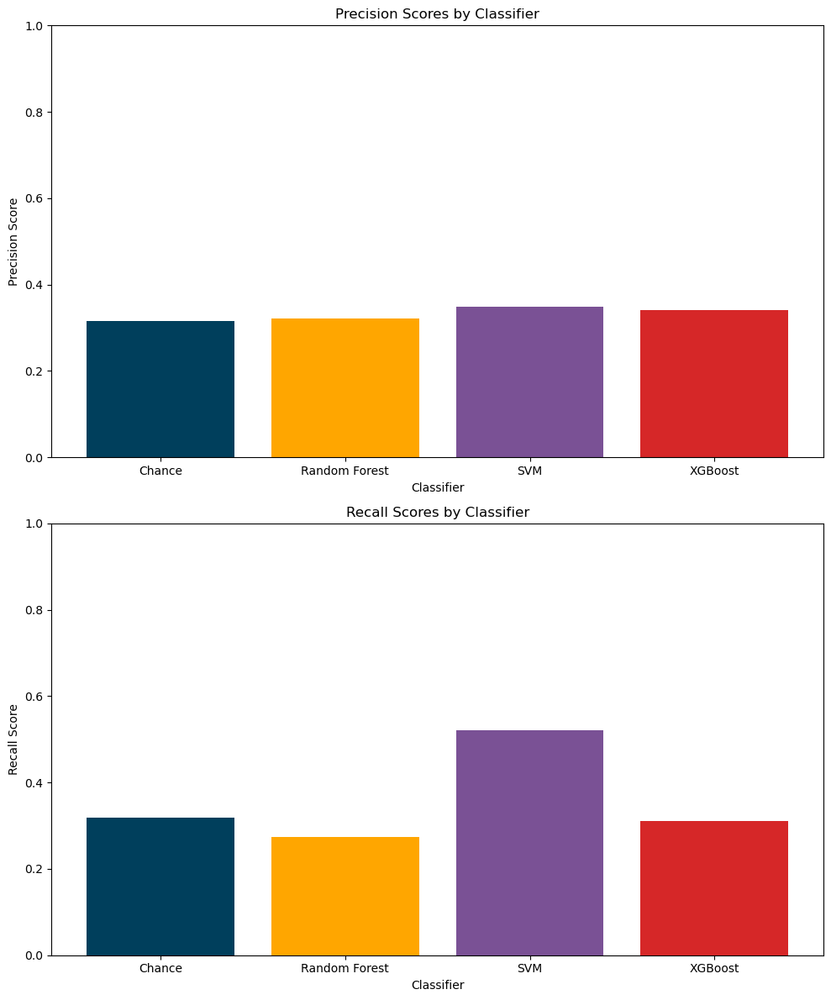

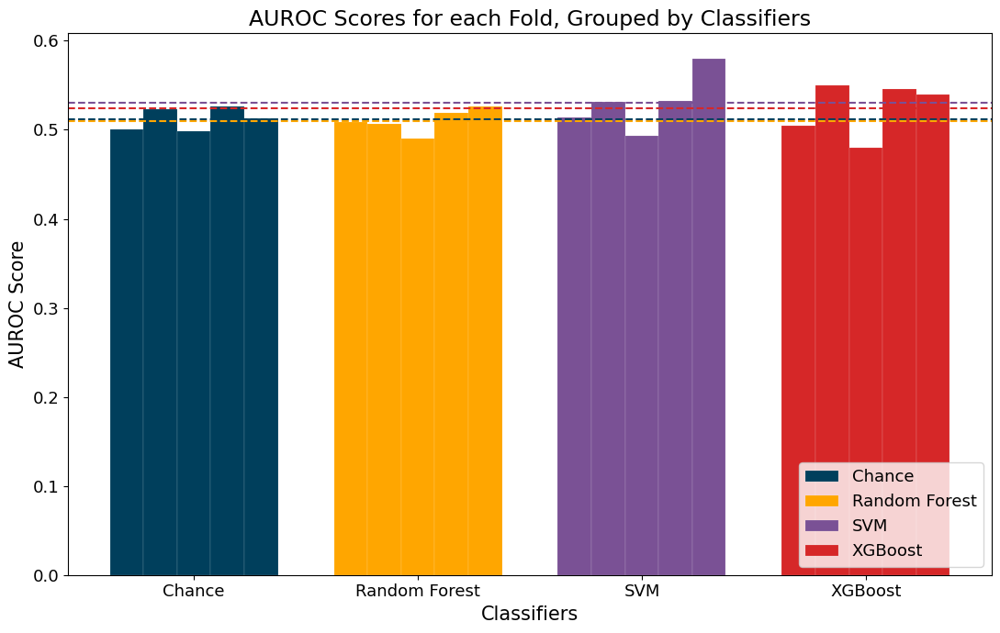

In [20]:
# WITH FEATURE SELECTION
#PRECISION
# Preparing the data
X = df_no_null[['PP_3_OffscreenProp', 'PP_OffscreenProp', 'PP_cluster_avg_duration', 'PP_OffscreenPix', 'PP_3_OffscreenPix', 
                'PP_3_Gazes', 'PP_3_AOI_Gazes', 'PP_cluster_sd_duration', 'PP_2_cluster_num_clusters', 'PP_cluster_skew_duration', 
                'PP_Gazes', 'PP_2_Gazes', 'PP_2_VBD', 'PP_2_DT', 'PP_2_cluster_avg_duration', 'PP_2_VBN', 'PP_NN', 'PP_2_dispersion', 
                'PP_2_cluster_skew_duration', 'PP_JJ', 'PP_dispersion', 'PP_2_cluster_sd_duration', 'wordCount_with_stopwords', 
                'PP_3_WRB', 'PP_3_cluster_skew_duration', 'ease_of_reading', 'syllableCount_with_stopwords', 'PP_CD', 'PP_DT', 
                'PP_2_AOI_Gazes', 'PP_3_cluster_sd_duration', 'PP_3_NN', 'PP_2_VB', 'wordCount_without_stopwords', 
                'syllableCount_without_stopwords', 'PP_3_VBP', 'PP_2_OffscreenProp', 'PP_3_dispersion', 'PP_2_VBZ', 
                'PP_VBD', 'PP_2_VBG', 'PP_3_VB', 'PP_3_VBG', 'PP_3_MD', 'PP_3_cluster_num_clusters', 'PP_RB', 'PP_3_IN'
]]
y = df_no_null['TUT']

# Identify majority and minority classes
majority_class = df_no_null['TUT'].value_counts().idxmax()
minority_class = df_no_null['TUT'].value_counts().idxmin()
print("Majority class", majority_class)
print("Minority class", minority_class)

# Separate majority and minority class samples
majority_indices = df_no_null[df_no_null['TUT'] == majority_class].index
minority_indices = df_no_null[df_no_null['TUT'] == minority_class].index

precision_scorer = make_scorer(precision_score)

plt.figure(figsize=(11, 7)) 

precision_dict = {}
recall_dict = {}

# List of classifiers
classifiers = {
    'Chance': DummyClassifier(strategy="stratified"),
    "Random Forest": RandomForestClassifier(n_estimators=100),
    "SVM": SVC(random_state=42, probability=True), 
    "XGBoost": xgb.XGBClassifier(random_state=42)
}
auroc_score_barplot = {name: [] for name in classifiers}

# Parameters for tuning classifiers
param_grid_RF = {
    'criterion': ['entropy', 'gini'],
    'max_depth': [10, 20],
    'max_features': ['sqrt', 'log2'],
    'min_samples_split': [2, 5, 10],
    'n_estimators': [50, 100, 200],
    }

param_grid_SVM = {
    'C': [0.1, 1, 10],
#     'gamma': [1, 0.1, 0.01, 0.001],
    'kernel': ['linear']
}
    

param_grid_XGB = {
    'colsample_bytree': [0.8, 1.0],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [10, 20],
    'min_child_weight': [1, 3, 5],
    'n_estimators': [50, 100, 200],
    'subsample': [0.8, 1.0],
}

param_grids = {
    'Random Forest': param_grid_RF,
    'SVM': param_grid_SVM,
    'XGBoost': param_grid_XGB
}

# Define the number of folds for cross-validation
n_splits = 5

# Define the GroupKFold object
gkf = GroupKFold(n_splits=n_splits)

# Loop through the classifiers
for name, clf in classifiers.items():
    # Initialize lists to store evaluation metrics for each fold
    accuracy_scores = []
    weighted_f1_scores = []
    precision_scores = []
    recall_scores = []
    auroc_scores = []
    confusion_matrices = []
    prediction_rates = []

    # Perform cross-validation
    for train_index, test_index in gkf.split(X, y, groups=df_no_null['Participant']):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Apply PCA on the training data
        pca = PCA(n_components=0.95)
        X_train_pca = pca.fit_transform(X_train)
        X_train_pca_df = pd.DataFrame(X_train_pca, columns=[f'PC{i}' for i in range(X_train_pca.shape[1])])

        
        # Perform oversampling on minority class
        smote = SMOTE()
        X_train_resampled, y_train_resampled = smote.fit_resample(X_train_pca_df, y_train)

        
#         print(f"Before SMOTE: {Counter(y_train)}")
#         print(f"After SMOTE: {Counter(y_train_resampled)}")

        # Apply the transformation to the test data
        X_test_pca = pca.transform(X_test)
        X_test_pca_df = pd.DataFrame(X_test_pca, columns=[f'PC{i}' for i in range(X_test_pca.shape[1])])

        
        # Perform hyperparamenter tuning and train classifiers on best parameters
        if name != "Chance":
            grid = GridSearchCV(clf, param_grids[name], refit=True, verbose=3, scoring=precision_scorer, n_jobs=-1)
            grid.fit(X_train_resampled, y_train_resampled)
            best_clf = grid.best_estimator_
            best_clf = best_clf.fit(X_train_resampled, y_train_resampled)
            # Perform prediction on test data
            y_pred = best_clf.predict(X_test_pca_df)

            # Calculating predicted probabilities for AUROC
            y_pred_proba = best_clf.predict_proba(X_test_pca_df)[:, 1] 

        else:
            best_clf = clf.fit(X_train, y_train)
            # Perform prediction on test data
            y_pred = best_clf.predict(X_test)

            # Calculating predicted probabilities for AUROC
            y_pred_proba = best_clf.predict_proba(X_test)[:, 1] 


        # Evaluation metrics
        accuracy = accuracy_score(y_test, y_pred)
        weighted_f1 = f1_score(y_test, y_pred, average='weighted')
        precision = precision_score(y_test, y_pred, pos_label=1, zero_division=0)  
        recall = recall_score(y_test, y_pred, pos_label=1, zero_division=0)
        auroc = roc_auc_score(y_test, y_pred_proba) 
        confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
        prediction_rate = (confusion_matrix[1, 1] + confusion_matrix[0, 1]) / (confusion_matrix[1, 1] + confusion_matrix[1, 0] + confusion_matrix[0, 1] + confusion_matrix[0, 0])

        
        # Append evaluation metrics to lists
        accuracy_scores.append(accuracy)
        weighted_f1_scores.append(weighted_f1)
        precision_scores.append(precision)
        recall_scores.append(recall)
        auroc_scores.append(auroc)
        confusion_matrices.append(confusion_matrix)
        prediction_rates.append(prediction_rate)

        #barplot for AUROC
        auroc_score_barplot[name].append(auroc)
        
    
    # Calculate average evaluation metrics across all folds
    avg_accuracy = np.mean(accuracy_scores)
    avg_weighted_f1 = np.mean(weighted_f1_scores)
    avg_precision = np.mean(precision_scores)
    avg_recall = np.mean(recall_scores)
    avg_auroc = np.mean(auroc_scores)
    avg_confusion_matrix = np.mean(confusion_matrices, axis=0)
    avg_prediction_rate = np.mean(prediction_rates)

    
    # Output the average evaluation metrics for each classifier
    print(f"{name} Results:")
    print(f"Avg Accuracy: {avg_accuracy:.2f}")
    print(f"Avg Weighted F1 Score: {avg_weighted_f1:.2f}")
    print(f"Avg Precision_1: {avg_precision:.2f}")
    print(f"Avg Recall_1: {avg_recall:.2f}")
    print(f"Avg AUROC: {avg_auroc:.2f}")
    print("Avg Confusion Matrix:")
    print(avg_confusion_matrix)
    print(f"Avg Prediction Rate: {avg_prediction_rate:.2f}\n")

    # Store the average precision and recall for each classifier in a dictionary
    precision_dict[name] = avg_precision
    recall_dict[name] = avg_recall
    

# List of colors for each classifier
colors = ['#003F5C', '#FFA600', '#7A5195', '#D62728']

# Plot bar charts for precision and recall
fig, ax = plt.subplots(2, 1, figsize=(10, 12))

# Precision plot
ax[0].bar(precision_dict.keys(), precision_dict.values(), color=colors)
ax[0].set_title('Precision Scores by Classifier')
ax[0].set_xlabel('Classifier')
ax[0].set_ylabel('Precision Score')
ax[0].set_ylim([0, 1])

# Recall plot
ax[1].bar(recall_dict.keys(), recall_dict.values(), color=colors)
ax[1].set_title('Recall Scores by Classifier')
ax[1].set_xlabel('Classifier')
ax[1].set_ylabel('Recall Score')
ax[1].set_ylim([0, 1])

plt.tight_layout()
plt.show()


# Plot bar chart for AUROC
fig, ax = plt.subplots(figsize=(11, 7))
bar_width = 0.15  
gap_width = 0.05 

bar_positions = np.arange(len(classifiers)) * (n_splits * (bar_width + gap_width))

for idx, name in enumerate(classifiers):
    scores = auroc_score_barplot[name]
    avg_score = np.mean(scores)
    for fold_idx, score in enumerate(scores):
        bar_pos = bar_positions[idx] + (fold_idx * bar_width)
        ax.bar(bar_pos, score, bar_width, label=name if fold_idx == 0 else "",
               color=colors[idx], edgecolor='white', linewidth=0.1, alpha=1)
    ax.axhline(y=avg_score, color=colors[idx], linestyle='dashed', linewidth=1.5)
ax.set_xlabel('Classifiers', fontsize=15)
ax.set_ylabel('AUROC Score', fontsize=15)
ax.set_title('AUROC Scores for each Fold, Grouped by Classifiers', fontsize=17)

ax.set_xticks(bar_positions + ((n_splits * bar_width) / 2) - (bar_width / 2))
ax.set_xticklabels(classifiers.keys())

# Increasing the font size for tick labels and legend
ax.tick_params(axis='both', which='major', labelsize=13)


ax.legend(loc='lower right', fontsize=13)

plt.tight_layout()
plt.show()


Majority class 0
Minority class 1
Chance Results:
Avg Accuracy: 0.55
Avg Weighted F1 Score: 0.55
Avg Precision_1: 0.31
Avg Recall_1: 0.31
Avg AUROC: 0.50
Avg Confusion Matrix:
[[176.2  90.8]
 [ 88.6  40. ]]
Avg Prediction Rate: 0.33

Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Random Forest Results:
Avg Accuracy: 0.59
Avg Weighted F1 Score: 0.58
Avg Precision_1: 0.35
Avg Recall_1: 0.30
Avg AUROC: 0.52
Avg Confusion Matrix:
[[194.4  72.6]
 [ 90.4  38.2]]
Avg Prediction Rate: 0.28

Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5

C:\Users\grace\anaconda3\Lib\site-packages\joblib\externals\loky\process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
XGBoost Results:
Avg Accuracy: 0.58
Avg Weighted F1 Score: 0.57
Avg Precision_1: 0.34
Avg Recall_1: 0.31
Avg AUROC: 0.51
Avg Confusion Matrix:
[[189.6  77.4]
 [ 89.2  39.4]]
Avg Prediction Rate: 0.30



<Figure size 1100x700 with 0 Axes>

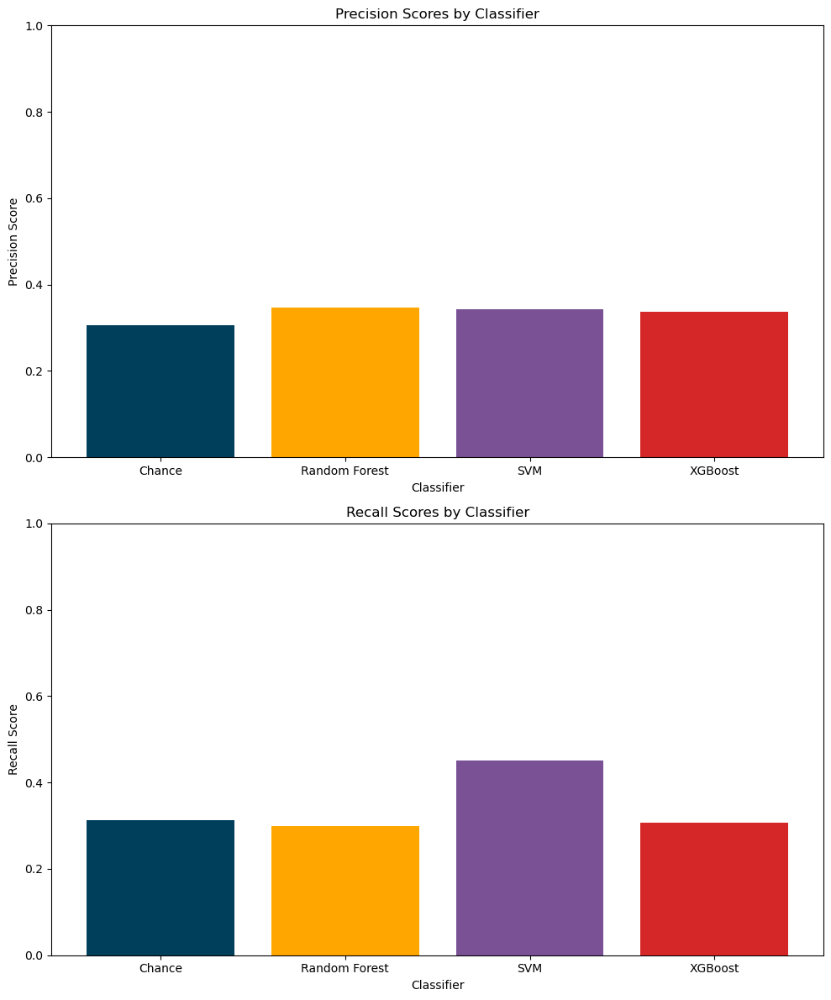

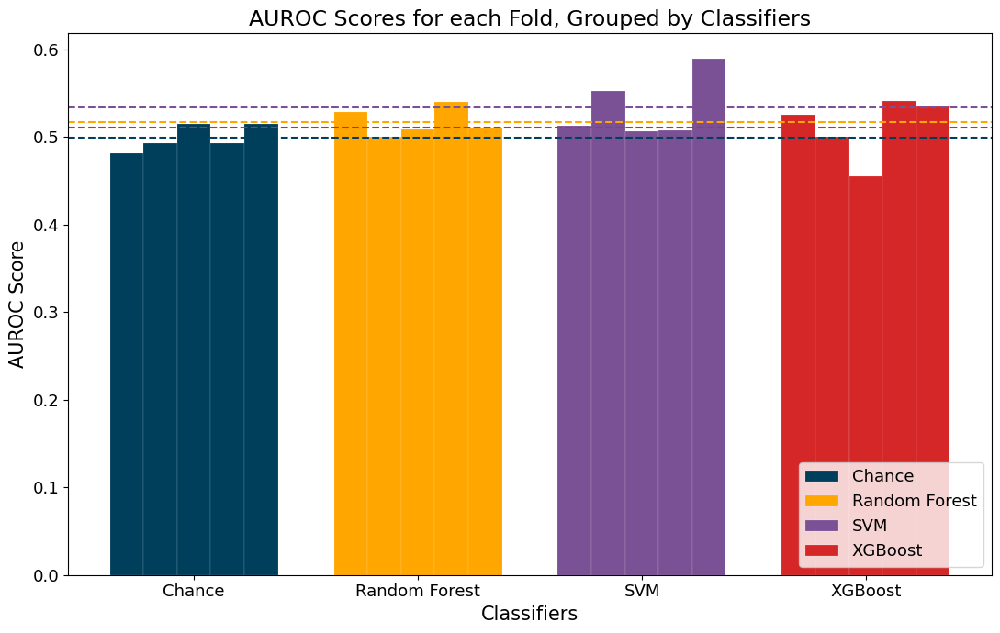

In [22]:
# WITHOUT FEATURE SELECTION
#PRECISION
# Preparing the data
X = df_no_null.drop(['Participant', 'Paragraph', 'TUT'], axis = 1)
y = df_no_null['TUT']

# Identify majority and minority classes
majority_class = df_no_null['TUT'].value_counts().idxmax()
minority_class = df_no_null['TUT'].value_counts().idxmin()
print("Majority class", majority_class)
print("Minority class", minority_class)

# Separate majority and minority class samples
majority_indices = df_no_null[df_no_null['TUT'] == majority_class].index
minority_indices = df_no_null[df_no_null['TUT'] == minority_class].index

precision_scorer = make_scorer(precision_score)

plt.figure(figsize=(11, 7)) 

precision_dict = {}
recall_dict = {}

# List of classifiers
classifiers = {
    'Chance': DummyClassifier(strategy="stratified"),
    "Random Forest": RandomForestClassifier(n_estimators=100),
    "SVM": SVC(random_state=42, probability=True), 
    "XGBoost": xgb.XGBClassifier(random_state=42)
}
auroc_score_barplot = {name: [] for name in classifiers}

# Parameters for tuning classifiers
param_grid_RF = {
    'criterion': ['entropy', 'gini'],
    'max_depth': [10, 20],
    'max_features': ['sqrt', 'log2'],
    'min_samples_split': [2, 5, 10],
    'n_estimators': [50, 100, 200],
    }

param_grid_SVM = {
    'C': [0.1, 1, 10],
#     'gamma': [1, 0.1, 0.01, 0.001],
    'kernel': ['linear']
}
    

param_grid_XGB = {
    'colsample_bytree': [0.8, 1.0],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [10, 20],
    'min_child_weight': [1, 3, 5],
    'n_estimators': [50, 100, 200],
    'subsample': [0.8, 1.0],
}

param_grids = {
    'Random Forest': param_grid_RF,
    'SVM': param_grid_SVM,
    'XGBoost': param_grid_XGB
}

# Define the number of folds for cross-validation
n_splits = 5

# Define the GroupKFold object
gkf = GroupKFold(n_splits=n_splits)

# Loop through the classifiers
for name, clf in classifiers.items():
    # Initialize lists to store evaluation metrics for each fold
    accuracy_scores = []
    weighted_f1_scores = []
    precision_scores = []
    recall_scores = []
    auroc_scores = []
    confusion_matrices = []
    prediction_rates = []

    # Perform cross-validation
    for train_index, test_index in gkf.split(X, y, groups=df_no_null['Participant']):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Apply PCA on the training data
        pca = PCA(n_components=0.95)
        X_train_pca = pca.fit_transform(X_train)
        X_train_pca_df = pd.DataFrame(X_train_pca, columns=[f'PC{i}' for i in range(X_train_pca.shape[1])])

        
        # Perform oversampling on minority class
        smote = SMOTE()
        X_train_resampled, y_train_resampled = smote.fit_resample(X_train_pca_df, y_train)

        
#         print(f"Before SMOTE: {Counter(y_train)}")
#         print(f"After SMOTE: {Counter(y_train_resampled)}")

        # Apply the transformation to the test data
        X_test_pca = pca.transform(X_test)
        X_test_pca_df = pd.DataFrame(X_test_pca, columns=[f'PC{i}' for i in range(X_test_pca.shape[1])])

        
        # Perform hyperparamenter tuning and train classifiers on best parameters
        if name != "Chance":
            grid = GridSearchCV(clf, param_grids[name], refit=True, verbose=3, scoring=precision_scorer, n_jobs=-1)
            grid.fit(X_train_resampled, y_train_resampled)
            best_clf = grid.best_estimator_
            best_clf = best_clf.fit(X_train_resampled, y_train_resampled)
            # Perform prediction on test data
            y_pred = best_clf.predict(X_test_pca_df)

            # Calculating predicted probabilities for AUROC
            y_pred_proba = best_clf.predict_proba(X_test_pca_df)[:, 1] 

        else:
            best_clf = clf.fit(X_train, y_train)
            # Perform prediction on test data
            y_pred = best_clf.predict(X_test)

            # Calculating predicted probabilities for AUROC
            y_pred_proba = best_clf.predict_proba(X_test)[:, 1] 


        # Evaluation metrics
        accuracy = accuracy_score(y_test, y_pred)
        weighted_f1 = f1_score(y_test, y_pred, average='weighted')
        precision = precision_score(y_test, y_pred, pos_label=1, zero_division=0)  
        recall = recall_score(y_test, y_pred, pos_label=1, zero_division=0)
        auroc = roc_auc_score(y_test, y_pred_proba) 
        confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
        prediction_rate = (confusion_matrix[1, 1] + confusion_matrix[0, 1]) / (confusion_matrix[1, 1] + confusion_matrix[1, 0] + confusion_matrix[0, 1] + confusion_matrix[0, 0])

        
        # Append evaluation metrics to lists
        accuracy_scores.append(accuracy)
        weighted_f1_scores.append(weighted_f1)
        precision_scores.append(precision)
        recall_scores.append(recall)
        auroc_scores.append(auroc)
        confusion_matrices.append(confusion_matrix)
        prediction_rates.append(prediction_rate)

        #barplot for AUROC
        auroc_score_barplot[name].append(auroc)
        
    
    # Calculate average evaluation metrics across all folds
    avg_accuracy = np.mean(accuracy_scores)
    avg_weighted_f1 = np.mean(weighted_f1_scores)
    avg_precision = np.mean(precision_scores)
    avg_recall = np.mean(recall_scores)
    avg_auroc = np.mean(auroc_scores)
    avg_confusion_matrix = np.mean(confusion_matrices, axis=0)
    avg_prediction_rate = np.mean(prediction_rates)

    
    # Output the average evaluation metrics for each classifier
    print(f"{name} Results:")
    print(f"Avg Accuracy: {avg_accuracy:.2f}")
    print(f"Avg Weighted F1 Score: {avg_weighted_f1:.2f}")
    print(f"Avg Precision_1: {avg_precision:.2f}")
    print(f"Avg Recall_1: {avg_recall:.2f}")
    print(f"Avg AUROC: {avg_auroc:.2f}")
    print("Avg Confusion Matrix:")
    print(avg_confusion_matrix)
    print(f"Avg Prediction Rate: {avg_prediction_rate:.2f}\n")

    # Store the average precision and recall for each classifier in a dictionary
    precision_dict[name] = avg_precision
    recall_dict[name] = avg_recall
    

# List of colors for each classifier
colors = ['#003F5C', '#FFA600', '#7A5195', '#D62728']

# Plot bar charts for precision and recall
fig, ax = plt.subplots(2, 1, figsize=(10, 12))

# Precision plot
ax[0].bar(precision_dict.keys(), precision_dict.values(), color=colors)
ax[0].set_title('Precision Scores by Classifier')
ax[0].set_xlabel('Classifier')
ax[0].set_ylabel('Precision Score')
ax[0].set_ylim([0, 1])

# Recall plot
ax[1].bar(recall_dict.keys(), recall_dict.values(), color=colors)
ax[1].set_title('Recall Scores by Classifier')
ax[1].set_xlabel('Classifier')
ax[1].set_ylabel('Recall Score')
ax[1].set_ylim([0, 1])

plt.tight_layout()
plt.show()


# Plot bar chart for AUROC
fig, ax = plt.subplots(figsize=(11, 7))
bar_width = 0.15  
gap_width = 0.05 

bar_positions = np.arange(len(classifiers)) * (n_splits * (bar_width + gap_width))

for idx, name in enumerate(classifiers):
    scores = auroc_score_barplot[name]
    avg_score = np.mean(scores)
    for fold_idx, score in enumerate(scores):
        bar_pos = bar_positions[idx] + (fold_idx * bar_width)
        ax.bar(bar_pos, score, bar_width, label=name if fold_idx == 0 else "",
               color=colors[idx], edgecolor='white', linewidth=0.1, alpha=1)
    ax.axhline(y=avg_score, color=colors[idx], linestyle='dashed', linewidth=1.5)
ax.set_xlabel('Classifiers', fontsize=15)
ax.set_ylabel('AUROC Score', fontsize=15)
ax.set_title('AUROC Scores for each Fold, Grouped by Classifiers', fontsize=17)

ax.set_xticks(bar_positions + ((n_splits * bar_width) / 2) - (bar_width / 2))
ax.set_xticklabels(classifiers.keys())

# Increasing the font size for tick labels and legend
ax.tick_params(axis='both', which='major', labelsize=13)


ax.legend(loc='lower right', fontsize=13)

plt.tight_layout()
plt.show()


Majority class 0
Minority class 1
Chance Results:
Avg Accuracy: 0.56
Avg Weighted F1 Score: 0.56
Avg Precision_1: 0.32
Avg Recall_1: 0.33
Avg AUROC: 0.50
Avg Confusion Matrix:
[[177.2  89.8]
 [ 86.   42.6]]
Avg Prediction Rate: 0.33

Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Fitting 5 folds for each of 72 candidates, totalling 360 fits
Random Forest Results:
Avg Accuracy: 0.52
Avg Weighted F1 Score: 0.54
Avg Precision_1: 0.33
Avg Recall_1: 0.45
Avg AUROC: 0.52
Avg Confusion Matrix:
[[149.2 117.8]
 [ 71.   57.6]]
Avg Prediction Rate: 0.44

Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Fitting 5

<Figure size 1100x700 with 0 Axes>

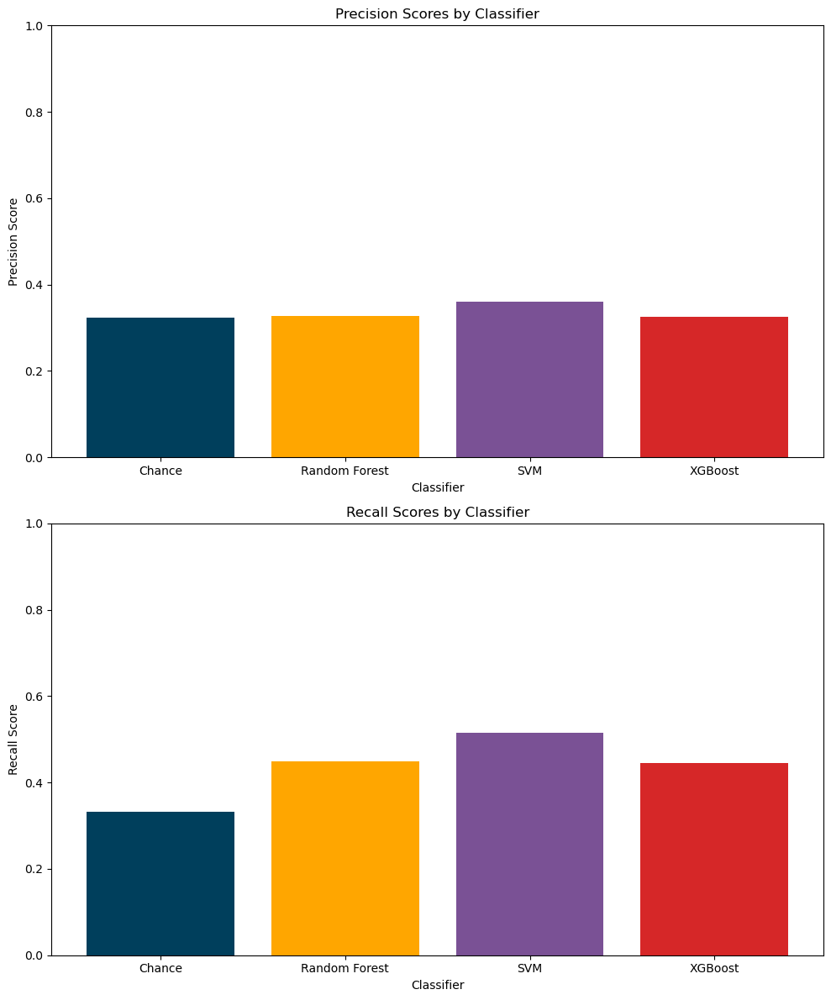

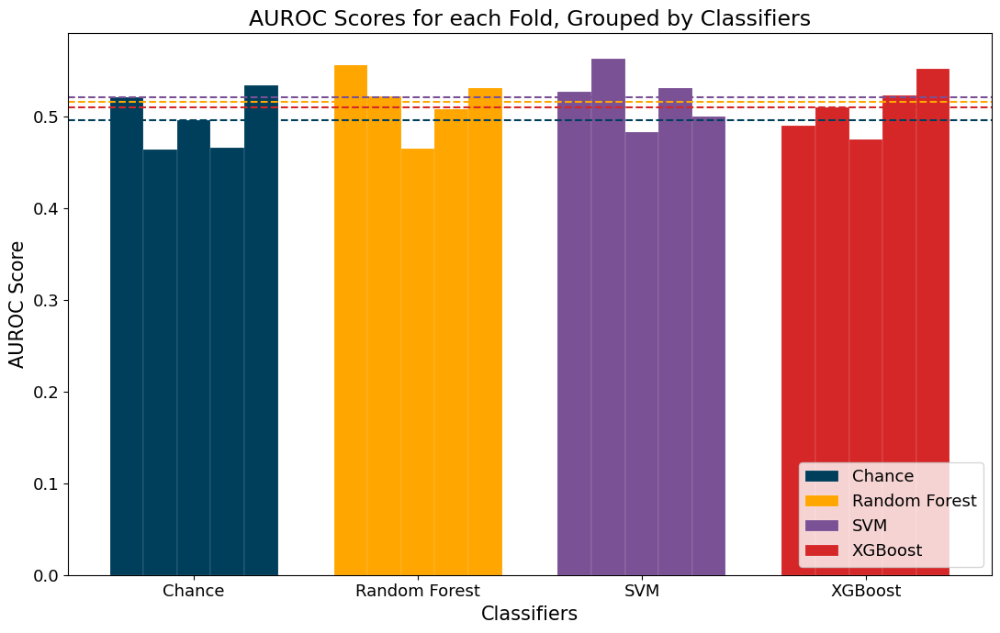

In [25]:
# WITH FEATURE SELECTION
#PRECISION
# Preparing the data
X = df_no_null.drop(['Participant', 'Paragraph', 'TUT'], axis = 1)
y = df_no_null['TUT']

# Identify majority and minority classes
majority_class = df_no_null['TUT'].value_counts().idxmax()
minority_class = df_no_null['TUT'].value_counts().idxmin()
print("Majority class", majority_class)
print("Minority class", minority_class)

# Separate majority and minority class samples
majority_indices = df_no_null[df_no_null['TUT'] == majority_class].index
minority_indices = df_no_null[df_no_null['TUT'] == minority_class].index

precision_scorer = make_scorer(precision_score)

plt.figure(figsize=(11, 7)) 

precision_dict = {}
recall_dict = {}

# List of classifiers
classifiers = {
    'Chance': DummyClassifier(strategy="stratified"),
    "Random Forest": RandomForestClassifier(n_estimators=100),
    "SVM": SVC(random_state=42, probability=True), 
    "XGBoost": xgb.XGBClassifier(random_state=42)
}
auroc_score_barplot = {name: [] for name in classifiers}

# Parameters for tuning classifiers
param_grid_RF = {
    'criterion': ['entropy', 'gini'],
    'max_depth': [10, 20],
    'max_features': ['sqrt', 'log2'],
    'min_samples_split': [2, 5, 10],
    'n_estimators': [50, 100, 200],
    }

param_grid_SVM = {
    'C': [0.1, 1, 10],
#     'gamma': [1, 0.1, 0.01, 0.001],
    'kernel': ['linear']
}
    

param_grid_XGB = {
    'colsample_bytree': [0.8, 1.0],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [10, 20],
    'min_child_weight': [1, 3, 5],
    'n_estimators': [50, 100, 200],
    'subsample': [0.8, 1.0],
}

param_grids = {
    'Random Forest': param_grid_RF,
    'SVM': param_grid_SVM,
    'XGBoost': param_grid_XGB
}

# Define the number of folds for cross-validation
n_splits = 5

# Define the GroupKFold object
gkf = GroupKFold(n_splits=n_splits)

# Loop through the classifiers
for name, clf in classifiers.items():
    # Initialize lists to store evaluation metrics for each fold
    accuracy_scores = []
    weighted_f1_scores = []
    precision_scores = []
    recall_scores = []
    auroc_scores = []
    confusion_matrices = []
    prediction_rates = []

    # Perform cross-validation
    for train_index, test_index in gkf.split(X, y, groups=df_no_null['Participant']):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Apply PCA on the training data
        pca = PCA(n_components=0.95)
        X_train_pca = pca.fit_transform(X_train)
        X_train_pca_df = pd.DataFrame(X_train_pca, columns=[f'PC{i}' for i in range(X_train_pca.shape[1])])

        
        # Perform undersampling on majority class
        rus = RandomUnderSampler(random_state=42)
        X_train_resampled, y_train_resampled = rus.fit_resample(X_train_pca_df, y_train)

        
#         print(f"Before SMOTE: {Counter(y_train)}")
#         print(f"After SMOTE: {Counter(y_train_resampled)}")

        # Apply the transformation to the test data
        X_test_pca = pca.transform(X_test)
        X_test_pca_df = pd.DataFrame(X_test_pca, columns=[f'PC{i}' for i in range(X_test_pca.shape[1])])

        
        # Perform hyperparamenter tuning and train classifiers on best parameters
        if name != "Chance":
            grid = GridSearchCV(clf, param_grids[name], refit=True, verbose=3, scoring=precision_scorer, n_jobs=-1)
            grid.fit(X_train_resampled, y_train_resampled)
            best_clf = grid.best_estimator_
            best_clf = best_clf.fit(X_train_resampled, y_train_resampled)
            # Perform prediction on test data
            y_pred = best_clf.predict(X_test_pca_df)

            # Calculating predicted probabilities for AUROC
            y_pred_proba = best_clf.predict_proba(X_test_pca_df)[:, 1] 

        else:
            best_clf = clf.fit(X_train, y_train)
            # Perform prediction on test data
            y_pred = best_clf.predict(X_test)

            # Calculating predicted probabilities for AUROC
            y_pred_proba = best_clf.predict_proba(X_test)[:, 1] 


        # Evaluation metrics
        accuracy = accuracy_score(y_test, y_pred)
        weighted_f1 = f1_score(y_test, y_pred, average='weighted')
        precision = precision_score(y_test, y_pred, pos_label=1, zero_division=0)  
        recall = recall_score(y_test, y_pred, pos_label=1, zero_division=0)
        auroc = roc_auc_score(y_test, y_pred_proba) 
        confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
        prediction_rate = (confusion_matrix[1, 1] + confusion_matrix[0, 1]) / (confusion_matrix[1, 1] + confusion_matrix[1, 0] + confusion_matrix[0, 1] + confusion_matrix[0, 0])

        
        # Append evaluation metrics to lists
        accuracy_scores.append(accuracy)
        weighted_f1_scores.append(weighted_f1)
        precision_scores.append(precision)
        recall_scores.append(recall)
        auroc_scores.append(auroc)
        confusion_matrices.append(confusion_matrix)
        prediction_rates.append(prediction_rate)

        #barplot for AUROC
        auroc_score_barplot[name].append(auroc)
        
    
    # Calculate average evaluation metrics across all folds
    avg_accuracy = np.mean(accuracy_scores)
    avg_weighted_f1 = np.mean(weighted_f1_scores)
    avg_precision = np.mean(precision_scores)
    avg_recall = np.mean(recall_scores)
    avg_auroc = np.mean(auroc_scores)
    avg_confusion_matrix = np.mean(confusion_matrices, axis=0)
    avg_prediction_rate = np.mean(prediction_rates)

    
    # Output the average evaluation metrics for each classifier
    print(f"{name} Results:")
    print(f"Avg Accuracy: {avg_accuracy:.2f}")
    print(f"Avg Weighted F1 Score: {avg_weighted_f1:.2f}")
    print(f"Avg Precision_1: {avg_precision:.2f}")
    print(f"Avg Recall_1: {avg_recall:.2f}")
    print(f"Avg AUROC: {avg_auroc:.2f}")
    print("Avg Confusion Matrix:")
    print(avg_confusion_matrix)
    print(f"Avg Prediction Rate: {avg_prediction_rate:.2f}\n")

    # Store the average precision and recall for each classifier in a dictionary
    precision_dict[name] = avg_precision
    recall_dict[name] = avg_recall
    

# List of colors for each classifier
colors = ['#003F5C', '#FFA600', '#7A5195', '#D62728']

# Plot bar charts for precision and recall
fig, ax = plt.subplots(2, 1, figsize=(10, 12))

# Precision plot
ax[0].bar(precision_dict.keys(), precision_dict.values(), color=colors)
ax[0].set_title('Precision Scores by Classifier')
ax[0].set_xlabel('Classifier')
ax[0].set_ylabel('Precision Score')
ax[0].set_ylim([0, 1])

# Recall plot
ax[1].bar(recall_dict.keys(), recall_dict.values(), color=colors)
ax[1].set_title('Recall Scores by Classifier')
ax[1].set_xlabel('Classifier')
ax[1].set_ylabel('Recall Score')
ax[1].set_ylim([0, 1])

plt.tight_layout()
plt.show()


# Plot bar chart for AUROC
fig, ax = plt.subplots(figsize=(11, 7))
bar_width = 0.15  
gap_width = 0.05 

bar_positions = np.arange(len(classifiers)) * (n_splits * (bar_width + gap_width))

for idx, name in enumerate(classifiers):
    scores = auroc_score_barplot[name]
    avg_score = np.mean(scores)
    for fold_idx, score in enumerate(scores):
        bar_pos = bar_positions[idx] + (fold_idx * bar_width)
        ax.bar(bar_pos, score, bar_width, label=name if fold_idx == 0 else "",
               color=colors[idx], edgecolor='white', linewidth=0.1, alpha=1)
    ax.axhline(y=avg_score, color=colors[idx], linestyle='dashed', linewidth=1.5)
ax.set_xlabel('Classifiers', fontsize=15)
ax.set_ylabel('AUROC Score', fontsize=15)
ax.set_title('AUROC Scores for each Fold, Grouped by Classifiers', fontsize=17)

ax.set_xticks(bar_positions + ((n_splits * bar_width) / 2) - (bar_width / 2))
ax.set_xticklabels(classifiers.keys())

# Increasing the font size for tick labels and legend
ax.tick_params(axis='both', which='major', labelsize=13)


ax.legend(loc='lower right', fontsize=13)

plt.tight_layout()
plt.show()
